In [1]:
import numpy as np
import os
import cv2
import random
import tensorflow as tf
from pathlib import Path
from tensorflow import keras
from tensorflow.keras import applications, losses, optimizers, metrics, Model
from tensorflow.keras.layers import Layer, Input, Dense, Flatten, Lambda, Conv2D, MaxPooling2D
from tensorflow.keras.applications import VGG16, vgg16
from matplotlib import gridspec
from matplotlib.image import imread
import matplotlib.pyplot as plt
from tensorflow.keras.applications.vgg16 import preprocess_input

In [2]:
# Check availability of GPU
import nvidia_smi 

GPU = 0
os.environ["CUDA_VISIBLE_DEVICES"] = '{}'.format(GPU)

gpus = tf.config.experimental.list_physical_devices('GPU')
print('GPU is', 'available' if gpus else 'NOT AVAILABLE')
print('Number GPUs Available: ', len(gpus))


# Restrict TensorFlow to only use the MENTIONED GPU
if gpus:
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
        tf.config.experimental.set_visible_devices(gpus[0], 'GPU')
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print('{} Physical GPUs, Logical GPU'.format(len(gpus), len(logical_gpus)))
        print('Memory growth set to: {} '.format(str(tf.config.experimental.get_memory_growth(gpus[0]))))
    except RuntimeError as e:
        # Visible devices must be set before GPUs have been initialized
        print(e)

GPU is available
Number GPUs Available:  1
1 Physical GPUs, Logical GPU
Memory growth set to: True 


2022-12-04 04:43:00.317437: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-12-04 04:43:00.791949: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1525] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43420 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:17:00.0, compute capability: 8.6


In [3]:
# Initiate NVIDIA-SMI
nvidia_smi.nvmlInit()
handle = nvidia_smi.nvmlDeviceGetHandleByIndex(GPU)

In [4]:
# ratio to resize to with cv2.resize(), needs to be (270, 480) if resizing is done with tf.keras.preprocessing.image.load_img()
IMG_SIZE = (480, 270) 

# number of directories used for benign anchor/positive images because we don't need thousands of them
DIR_SIZE = 500

# limit for the number of images read per directory to prevent OOM
COUNT_PER_DIR = 30

# limit for the number of triplets to read per triplet category to prevent OOM
NUM_TRIPLETS = 300

# number of epochs to run per training iteration
EPOCHS = 5

## Reading the training dataset, preprocessing, and generating the triplets

In [5]:
class PreProcessing:

    # training images, labels, and unique labels
    images_train = np.array([])
    labels_train = np.array([])
    unique_train_label = np.array([])

    # map cluster labels to training image indices belonging to that cluster
    map_train_label_indices = dict()

    def __init__(self, data_src, benign_anc_path, benign_pos_path, benign_neg_path):
        self.data_src = data_src
        
        # path to the anchor/positive negative images
        self.benign_anc_path = benign_anc_path
        self.benign_pos_path = benign_pos_path
        self.benign_neg_path = benign_neg_path
        
        print("Loading the Dataset...")
        self.images_train, self.labels_train = self.preprocessing()
        self.unique_train_label = np.unique(self.labels_train)
        self.map_train_label_indices = {label: np.flatnonzero(self.labels_train == label) for label in
                                        self.unique_train_label}
        
        # starting idxs for benign anchor/pos/neg directories
        # needed when getting triplets to locate the respective directories
        self.benign_anc_start = len(os.listdir(self.data_src)) # ex. 23 
        self.benign_pos_start = self.benign_anc_start + DIR_SIZE # ex. 23 + 500 = 523
        self.benign_neg_start = self.benign_pos_start + DIR_SIZE # ex. 523 + 500 = 1023

        print('Preprocessing Done. Summary:')
        print("Images train :", self.images_train.shape)
        print("Labels train :", self.labels_train.shape)
        print("Unique label :", self.unique_train_label)

    def read_dataset(self):
        
        # count how many images we are reading prior so that we don't iteratively append to the array 
        count = 0
        directories = os.listdir(self.data_src)
        
        # without this, the directories will be ordered as such: "1", "100", "2", ...
        directories.sort(key=int)
        
        # add all counts of images in each of the malicious page screenshot directories
        for directory in directories:
            count += len([file for file in os.listdir(os.path.join(self.data_src, directory))])

        # increment count by 1 per directory since only 1 anchor image is used per directory
        benign_anc_dir = os.listdir(self.benign_anc_path)
        benign_anc_dir.sort(key=int)
        for b_dir in benign_anc_dir[:DIR_SIZE]:
            count += 1

        # 30 images are selected per positive directory (could be adjusted per need)
        benign_pos_dir = os.listdir(self.benign_pos_path)
        benign_pos_dir.sort(key=int)
        for b_dir in benign_pos_dir[:DIR_SIZE]:
            count += COUNT_PER_DIR

        # all benign images from the single negative directory is read
        benign_neg_dir = os.listdir(self.benign_neg_path)
        benign_neg_dir.sort(key=int)
        for b_dir in benign_neg_dir:
            count += len([file for file in os.listdir(os.path.join(self.benign_neg_path, b_dir))])

        X = [None] * count
        y = [None] * count
        idx = 0

        # read malicious images
        for directory in directories:
            try:
                print('Read directory: ', directory)
                for pic in os.listdir(os.path.join(self.data_src, directory)):
                    img = tf.keras.preprocessing.image.load_img(os.path.join(self.data_src, directory, pic),interpolation='bilinear')
                    img = tf.keras.preprocessing.image.img_to_array(img)
                    img = cv2.resize(img, IMG_SIZE)

                    X[idx] = preprocess_input(img)                    
                    y[idx] = directory
                    idx += 1

            except Exception as e:
                print('Failed to read images from Directory: ', directory)
                print('Exception Message: ', e)
                
        # read benign anchor images
        for b_dir in benign_anc_dir[:DIR_SIZE]:
            try:
                print('Read benign anchor directory: ', b_dir)
                for pic in os.listdir(os.path.join(self.benign_anc_path, b_dir)):
                    img = tf.keras.preprocessing.image.load_img(os.path.join(self.benign_anc_path, b_dir, pic),interpolation='bilinear')
                    img = tf.keras.preprocessing.image.img_to_array(img)
                    img = cv2.resize(img, IMG_SIZE)

                    X[idx] = preprocess_input(img)
                    # 10,000 offset to prevent labels from overlapping
                    y[idx] = int(b_dir) + 10000
                    idx += 1

            except Exception as e:
                print('Failed to read images from Directory: ', directory)
                print('Exception Message: ', e)
                
        # read benign positive images (augmented)
        for b_dir in benign_pos_dir[:DIR_SIZE]:
            try:
                print('Read benign positive directory: ', b_dir)
                for pic in os.listdir(os.path.join(self.benign_pos_path, b_dir))[:30]:
                    img = tf.keras.preprocessing.image.load_img(os.path.join(self.benign_pos_path, b_dir, pic),interpolation='bilinear')
                    img = tf.keras.preprocessing.image.img_to_array(img)
                    img = cv2.resize(img, IMG_SIZE)

                    X[idx] = preprocess_input(img)
                    # 20,000 offset to prevent labels from overlapping
                    y[idx] = int(b_dir) + 20000
                    idx += 1

            except Exception as e:
                print('Failed to read images from Directory: ', directory)
                print('Exception Message: ', e)
        
        # read benign negative images
        for b_dir in benign_neg_dir:
            try:
                print('Read benign negative directory: ', b_dir)
                for pic in os.listdir(os.path.join(self.benign_neg_path, b_dir)):
                    img = tf.keras.preprocessing.image.load_img(os.path.join(self.benign_neg_path, b_dir, pic),interpolation='bilinear')
                    img = tf.keras.preprocessing.image.img_to_array(img)
                    img = cv2.resize(img, IMG_SIZE)

                    X[idx] = preprocess_input(img)
                    # 30,000 offset to prevent labels from overlapping
                    y[idx] = int(b_dir) + 30000
                    idx += 1

            except Exception as e:
                print('Failed to read images from Directory: ', b_directory)
                print('Exception Message: ', e)
                             
        print('Dataset loaded successfully.')
        return X,y

    def preprocessing(self):
        X, y = self.read_dataset()

        labels = list(set(y))
        labels.sort(key=int)
        
        # map random directory numbers to 0, 1, 2, ... n-1 and store the mapped labels in Y
        label_dict = dict(zip(labels, range(len(labels))))
        Y = np.asarray([label_dict[label] for label in y])        

        # shuffle the images and labels (in the same order)
        shuffle_indices = np.random.permutation(np.arange(len(y)))
        x_shuffled = []
        y_shuffled = []
        
        for index in shuffle_indices:
            x_shuffled.append(X[index])
            y_shuffled.append(Y[index])
        
        return np.asarray(x_shuffled), np.asarray(y_shuffled)

    # (mal, mal, mal) triplet
    def get_triplets(self):
        # include only the malicious cluster labels (label 0 - 23)
        exclude_benign = self.unique_train_label[:self.benign_anc_start]
        
        # label_l is the cluster label from which we choose 2 indices (of anchor & positive training images) from
        # label_r is another cluster label from which we choose 1 index (of negative training image) from
        label_l, label_r = np.random.choice(exclude_benign, 2, replace=False)
        
        # a = anchor, p = positive, n = negative index
        a, p = np.random.choice(self.map_train_label_indices[label_l],2, replace=False)
        n = np.random.choice(self.map_train_label_indices[label_r])
        return a, p, n

    # (mal, mal, benign) triplet
    def get_benign_triplets_1(self):
        # get a random malicious cluster label (from label 0 - 22)
        label_l = np.random.choice(self.unique_train_label[:self.benign_anc_start])

        # get a benign anchor image cluster label (from label 23 - 522)
        label_r = np.random.choice(self.unique_train_label[self.benign_anc_start:self.benign_pos_start])
        
        a, p = np.random.choice(self.map_train_label_indices[label_l],2, replace=False)
        n = np.random.choice(self.map_train_label_indices[label_r])
        
        return a, p, n
    
    # (benign, benign, mal) triplet
    def get_benign_triplets_2(self):
        # get a random anchor benign image cluster label (from label 23 - 522)
        label_a = np.random.choice(self.unique_train_label[self.benign_anc_start:self.benign_pos_start])
        # get a corresponding benign positive image cluster label (from label 523 - 1022)
        label_p = label_a + DIR_SIZE
        # get a malicious image cluster label (from label 0 - 22)
        label_n = np.random.choice(self.unique_train_label[self.benign_anc_start])

        a = np.random.choice(self.map_train_label_indices[label_a])
        p = np.random.choice(self.map_train_label_indices[label_p])
        n = np.random.choice(self.map_train_label_indices[label_n])
        
        return a, p, n        
    
    # (benign, benign, benign) triplet
    def get_benign_triplets_3(self):
        # get a random anchor benign image cluster label (from label 23 - 522)
        label_a = np.random.choice(self.unique_train_label[self.benign_anc_start:self.benign_pos_start])
        # get a corresponding benign positive image cluster label (from label 523 - 1022)
        label_p = label_a + DIR_SIZE
        # get a benign negative image cluster label (from label 1023)
        label_n = self.unique_train_label[self.benign_neg_start]

        a = np.random.choice(self.map_train_label_indices[label_a])
        p = np.random.choice(self.map_train_label_indices[label_p])
        n = np.random.choice(self.map_train_label_indices[label_n])
        
        return a, p, n

    def get_triplets_batch(self):
        idxs_a, idxs_p, idxs_n = [], [], []
        
        # generate 300 triplets per triplet combination (to prevent OOM)
        # (mal, mal, mal) 
        for i in range(NUM_TRIPLETS):
            a, p, n = self.get_triplets()
            idxs_a.append(a)
            idxs_p.append(p)
            idxs_n.append(n)
        
        # (mal, mal, benign)
        for _ in range(NUM_TRIPLETS):
            a, p, n = self.get_benign_triplets_1()
            idxs_a.append(a)
            idxs_p.append(p)
            idxs_n.append(n)
            
        # (benign, benign, mal)
        for _ in range(NUM_TRIPLETS):
            a, p, n = self.get_benign_triplets_2()
            idxs_a.append(a)
            idxs_p.append(p)
            idxs_n.append(n)
            
        # (benign, benign, benign)
        for _ in range(NUM_TRIPLETS):
            a, p, n = self.get_benign_triplets_3()
            idxs_a.append(a)
            idxs_p.append(p)
            idxs_n.append(n)
            
        # shuffling to prevent bias because val_dataset is later taken from the last 20% of the dataset
        shuffle_indices = np.random.permutation(np.arange(NUM_TRIPLETS * 4))
        a_shuffled = []
        p_shuffled = []
        n_shuffled = []
        
        for index in shuffle_indices:
            a_shuffled.append(idxs_a[index])
            p_shuffled.append(idxs_p[index])
            n_shuffled.append(idxs_n[index])

        anchor_dataset = tf.data.Dataset.from_tensor_slices(self.images_train[a_shuffled,:])
        positive_dataset = tf.data.Dataset.from_tensor_slices(self.images_train[p_shuffled,:])
        negative_dataset = tf.data.Dataset.from_tensor_slices(self.images_train[n_shuffled, :])

        dataset = tf.data.Dataset.zip((anchor_dataset, positive_dataset, negative_dataset))
        
        return dataset

In [6]:
dataset = PreProcessing('/data/InJoon/1.5.dataset before augmentation and testing/malicious/train-augmented8000/train-1', 
                        '/data/InJoon/1.5.dataset before augmentation and testing/benign/benign triplets3/anchors', 
                        '/data/InJoon/1.5.dataset before augmentation and testing/benign/benign triplets3/positive', 
                        '/data/InJoon/1.5.dataset before augmentation and testing/benign/benign triplets3/benign')

Loading the Dataset...
Read directory:  0
Read directory:  1
Read directory:  2
Read directory:  3
Read directory:  4
Read directory:  5
Read directory:  6
Read directory:  9
Read directory:  10
Read directory:  11
Read directory:  14
Read directory:  16
Read directory:  17
Read directory:  21
Read directory:  22
Read directory:  23
Read directory:  26
Read directory:  31
Read directory:  34
Read directory:  36
Read directory:  41
Read directory:  45
Read directory:  61
Read benign anchor directory:  0
Read benign anchor directory:  1
Read benign anchor directory:  2
Read benign anchor directory:  3
Read benign anchor directory:  4
Read benign anchor directory:  5
Read benign anchor directory:  6
Read benign anchor directory:  7
Read benign anchor directory:  8
Read benign anchor directory:  9
Read benign anchor directory:  10
Read benign anchor directory:  11
Read benign anchor directory:  12
Read benign anchor directory:  13
Read benign anchor directory:  14
Read benign anchor direct

## Move benign images to test directory

In [12]:
import shutil

# num_images = 5
# benign_org_path = '/data/InJoon/1.5.dataset before augmentation and testing/benign/benign triplets3/benign/0/'
# benign_test_path = '/data/InJoon/1.5.dataset before augmentation and testing/malicious/test-1/100/'

# images_to_move = os.listdir(benign_org_path)[:num_images]

# for img in images_to_move:
#     org_path = os.path.join(benign_org_path, img)
#     new_path = os.path.join(benign_test_path, img)
#     shutil.move(org_path, new_path)

## Visualize triplets

- Helps us see if the triplets are generated as expected

In [7]:
data = dataset.get_triplets_batch() # returns a zip dataset

In [8]:
# unzip the zip dataset
anchors, positives, negatives = tf.data.Dataset.get_single_element(data.batch(len(data)))

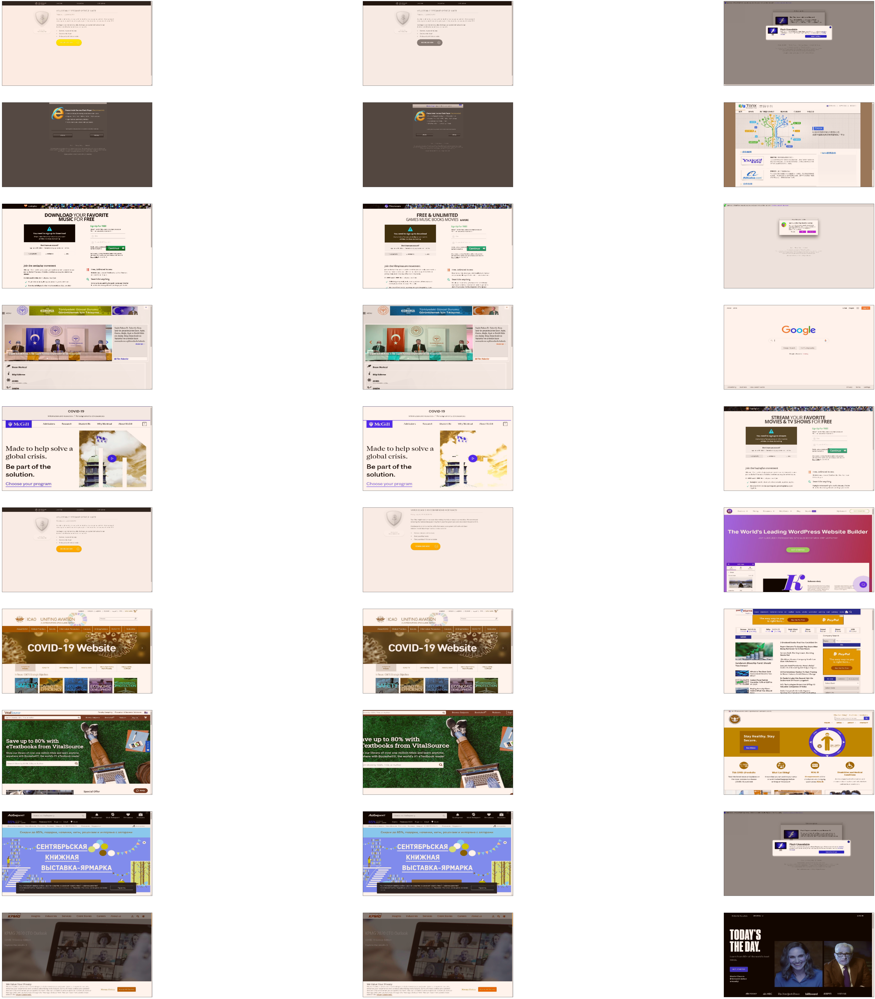

In [10]:
def normalize(x):
    min_val = np.min(x)
    max_val = np.max(x)
    x = (x - min_val) / (max_val - min_val)
    return x

def show(ax, image):
    ax.imshow(normalize(image))
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

COLS = 3
ROWS = 10
fig_len = ROWS * COLS
fig,axs = plt.subplots(ROWS,COLS,figsize=(100, 100))

# visualize 10 triplets
for i in range(ROWS):
    show(axs[i,0], anchors[i])
    show(axs[i,1], positives[i])
    show(axs[i,2], negatives[i])

## Define the model, the distance layer, and the overarching siamese network with triplet loss

In [11]:
class TripletLoss:

    # class is defined so that self.out is stored and is used as the output for fine tuning
    # if fine tuning is not used, the embedding could just be made without defining this class
    def __init__(self):
        # input shape (None, None, 3) possible due to 1x1 fully convolutional layer
        self.inp = tf.keras.Input(shape=(None, None, 3))
        self.out = []
    
    def embedding(self):
        # calling the vgg16 model
        vgg16_fe = tf.keras.applications.VGG16(include_top=False, input_tensor=self.inp)
        vgg16_fe.trainable = False

        # 1x1 fully convolutional layer is added to allow variable input sizes
        out_conv = tf.keras.layers.Conv2D(filters=16, kernel_size=1, strides=(1, 1), activation='relu', padding='same', name='out_conv')(vgg16_fe.layers[-1].output)
        gmp = tf.keras.layers.GlobalMaxPool2D()(out_conv)
        self.out = Flatten()(gmp)

        return Model(inputs=vgg16_fe.inputs, outputs=[self.out], name='embedding')
    
    def fine_tune(self, model):
        model.trainable = True
        freeze_until = 15
        for layer in model.layers[:freeze_until]:
            layer.trainable = False
        
        return Model(inputs=model.inputs, outputs=self.out)

In [12]:
class DistanceLayer(Layer):
    """
    This layer is responsible for computing the distance between the anchor
    embedding and the positive embedding, and the anchor embedding and the
    negative embedding.
    """

    def __init__(self, **kwargs):
        super().__init__(**kwargs)

    # computes the distance between the anchor & positive pair, and anchor & negative pair
    def call(self, anchor, positive, negative):
        ap_distance = tf.reduce_sum(tf.square(anchor - positive), -1)
        an_distance = tf.reduce_sum(tf.square(anchor - negative), -1)
        return (ap_distance, an_distance)

In [13]:
# from the official keras documentation: https://keras.io/examples/vision/siamese_network/
class SiameseModel(Model):
    """The Siamese Network model with a custom training and testing loops.

    Computes the triplet loss using the three embeddings produced by the
    Siamese Network.

    The triplet loss is defined as:
       L(A, P, N) = max(‖f(A) - f(P)‖² - ‖f(A) - f(N)‖² + margin, 0)
    """

    def __init__(self, siamese_network, margin=0.5):
        super(SiameseModel, self).__init__()
        self.siamese_network = siamese_network
        self.margin = margin
        self.loss_tracker = metrics.Mean(name="loss")

    def call(self, inputs):
        return self.siamese_network(inputs)

    def train_step(self, data):
        
        with tf.GradientTape() as tape:
            loss = self._compute_loss(data)

        # Storing the gradients of the loss function with respect to the
        # weights/parameters.
        gradients = tape.gradient(loss, self.siamese_network.trainable_weights)

        # Applying the gradients on the model using the specified optimizer
        self.optimizer.apply_gradients(
            zip(gradients, self.siamese_network.trainable_weights)
        )

        self.loss_tracker.update_state(loss)
        return {"loss": self.loss_tracker.result()}

    def test_step(self, data):
        loss = self._compute_loss(data)

        self.loss_tracker.update_state(loss)
        return {"loss": self.loss_tracker.result()}

    def _compute_loss(self, data):

        ap_distance, an_distance = self.siamese_network(data)

        # Computing the Triplet Loss by subtracting both distances and
        # making sure we don't get a negative value.
        loss = ap_distance - an_distance
        loss = tf.maximum(loss + self.margin, 0.0)
        return loss

    @property
    def metrics(self):
        # List metrics here so the `reset_states()` can be called automatically.
        return [self.loss_tracker]

## Train the model in a loop

- The main reason for running the fit() function multiple times in a loop is because of the limited number of triplets we generate at a time with data.get_triplets_batch()
- 5 epochs are run per iteration and the weights from the current iteration is saved to be used in the following iteration

In [14]:
model = TripletLoss()
target_shape = (None,None)
saving_path = '/home/tf/jupyter/models'

# defining the training and validation datasets used for first iteration in train_loop()
# validation dataset is only defined once here
triplets_count = 4 * NUM_TRIPLETS
data = dataset.get_triplets_batch()
train_dataset = data.take(round(triplets_count * 0.8))
val_dataset = data.skip(round(triplets_count * 0.8))

train_dataset = train_dataset.batch(16, drop_remainder=False)
train_dataset = train_dataset.prefetch(8)
val_dataset = val_dataset.batch(16, drop_remainder=False)
val_dataset = val_dataset.prefetch(8)

# defining the inputs
anchor_input = Input(name="anchor", shape=target_shape + (3,))
positive_input = Input(name="positive", shape=target_shape + (3,))
negative_input = Input(name="negative", shape=target_shape + (3,))

def train_loop(size, train_dataset, val_dataset):
    for i in range(0, size):
        print("loop:", i)
        embedding = model.embedding()

        # generate a new combination of triplets every iteration and load weights from the previous iteration
        if i > 0:
            train_dataset = dataset.get_triplets_batch()
            train_dataset = train_dataset.batch(16, drop_remainder=False)
            train_dataset = train_dataset.prefetch(8)
            embedding.load_weights(os.path.join(saving_path, 'model-' + str(i-1) + '.h5'))

        # distance layer computes the distance for each embedding (from the official keras doc)
        distances = DistanceLayer()(
            embedding(anchor_input),
            embedding(positive_input),
            embedding(negative_input),
        )

        # siamese network (from the official keras doc)
        siamese_network = Model(
            inputs=[anchor_input, positive_input, negative_input], outputs=distances
        )

        callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5)
        siamese_model = SiameseModel(siamese_network)
        siamese_model.compile(optimizer=optimizers.Adam(0.0001), metrics=['accuracy'])
        siamese_model.fit(train_dataset, epochs=EPOCHS, validation_data=val_dataset, callbacks=[callback])

        # save the weights from the current iteration
        model_h5_path = os.path.join(saving_path, 'model-' + str(i) + '.h5')
        embedding.save_weights(model_h5_path)
        
    return embedding

embedding = train_loop(50, train_dataset, val_dataset)

loop: 0
Epoch 1/5


2022-12-04 04:50:57.723736: I tensorflow/stream_executor/cuda/cuda_dnn.cc:366] Loaded cuDNN version 8301


60/60 [==============================] - 23s 274ms/step - loss: 48.5004 - val_loss: 16.5907
Epoch 2/5
60/60 [==============================] - 16s 273ms/step - loss: 35.5358 - val_loss: 15.3587
Epoch 3/5
60/60 [==============================] - 16s 270ms/step - loss: 25.7354 - val_loss: 14.3637
Epoch 4/5
60/60 [==============================] - 16s 271ms/step - loss: 18.8471 - val_loss: 13.7731
Epoch 5/5
60/60 [==============================] - 16s 273ms/step - loss: 13.9369 - val_loss: 13.4040
loop: 1
Epoch 1/5
75/75 [==============================] - 19s 246ms/step - loss: 23.2328 - val_loss: 12.7098
Epoch 2/5
75/75 [==============================] - 18s 247ms/step - loss: 16.5788 - val_loss: 12.2893
Epoch 3/5
75/75 [==============================] - 16s 220ms/step - loss: 12.4785 - val_loss: 11.1411
Epoch 4/5
75/75 [==============================] - 15s 202ms/step - loss: 9.4977 - val_loss: 10.2292
Epoch 5/5
75/75 [==============================] - 15s 204ms/step - loss: 7.5114 - va

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



75/75 [==============================] - 16s 212ms/step - loss: 0.2222 - val_loss: 2.1831
loop: 48
Epoch 1/5
75/75 [==============================] - 17s 213ms/step - loss: 3.2895 - val_loss: 1.7770
Epoch 2/5
75/75 [==============================] - 16s 210ms/step - loss: 1.8571 - val_loss: 2.0143
Epoch 3/5
75/75 [==============================] - 16s 210ms/step - loss: 1.0422 - val_loss: 2.2745
Epoch 4/5
75/75 [==============================] - 16s 208ms/step - loss: 0.6619 - val_loss: 2.3220
Epoch 5/5
75/75 [==============================] - 16s 211ms/step - loss: 0.4826 - val_loss: 2.3368


## Get similiarity scores between samples

- Helps us see if we get the similarity scores we expect between an anchor & positive pair and an anchor & negative pair

In [33]:
data = dataset.get_triplets_batch()

In [34]:
anchors, positives, negatives = tf.data.Dataset.get_single_element(data.batch(len(data)))

In [35]:
anchor_embedding, positive_embedding, negative_embedding = (
    embedding(tf.expand_dims(anchors[0], axis=0)),
    embedding(tf.expand_dims(positives[0], axis=0)),
    embedding(tf.expand_dims(negatives[0], axis=0)),
)

In [36]:
cosine_similarity = metrics.CosineSimilarity()
positive_similarity = cosine_similarity(anchor_embedding, positive_embedding)

print("Positive similarity:", positive_similarity.numpy())

Positive similarity: 0.95867693


In [37]:
cosine_similarity = metrics.CosineSimilarity()
negative_similarity = cosine_similarity(anchor_embedding, negative_embedding)

print("Negative similarity", negative_similarity.numpy())

Negative similarity 0.52612144


In [38]:
cosine_similarity = metrics.CosineSimilarity()

same = cosine_similarity(anchor_embedding, anchor_embedding)
same.numpy()

1.0

## Visualize triplets with similarity scores

Loop 0 Positive similarity 0.958677 Negative similarity 0.526121


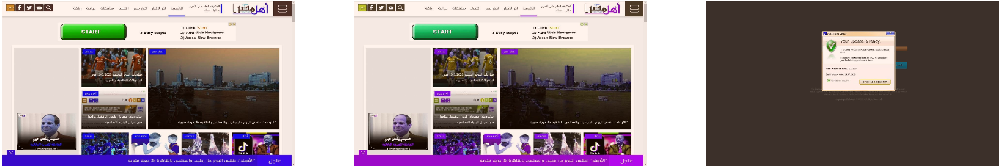

Loop 1 Positive similarity 0.994462 Negative similarity 0.778926


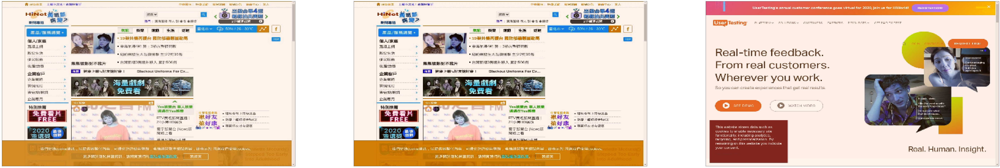

Loop 2 Positive similarity 0.845661 Negative similarity 0.808067


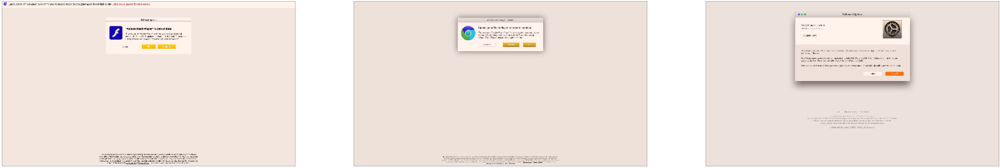

Loop 3 Positive similarity 0.872712 Negative similarity 0.568876


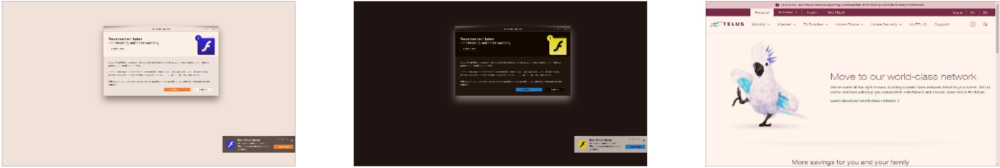

Loop 4 Positive similarity 0.986496 Negative similarity 0.624358


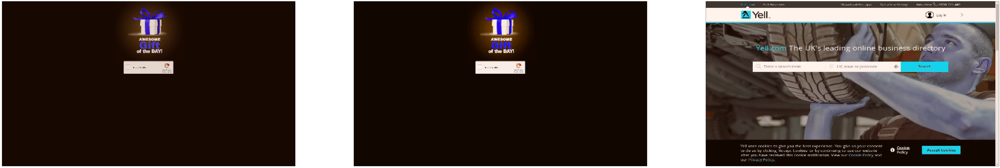

Loop 5 Positive similarity 0.938015 Negative similarity 0.897426


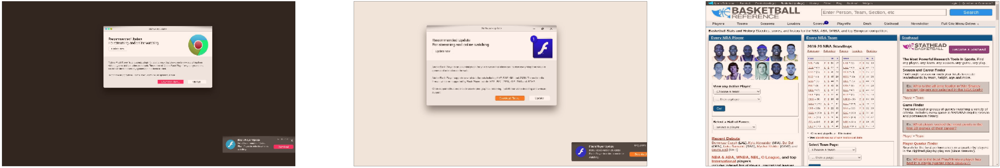

Loop 6 Positive similarity 0.937633 Negative similarity 0.92681


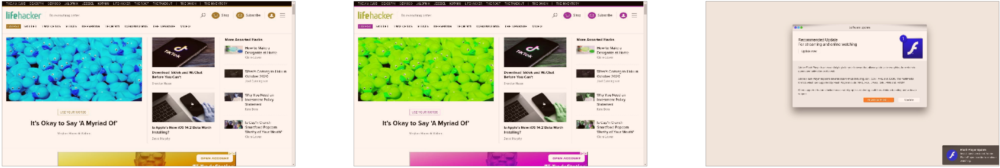

Loop 7 Positive similarity 0.998698 Negative similarity 0.742296


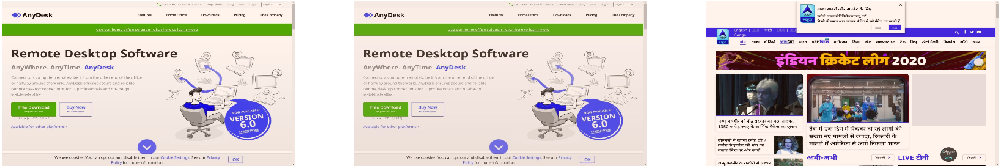

Loop 8 Positive similarity 0.917423 Negative similarity 0.693888


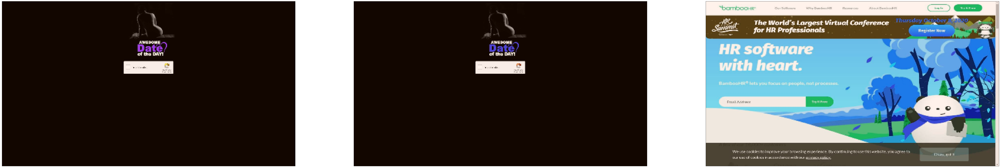

Loop 9 Positive similarity 0.931375 Negative similarity 0.730654


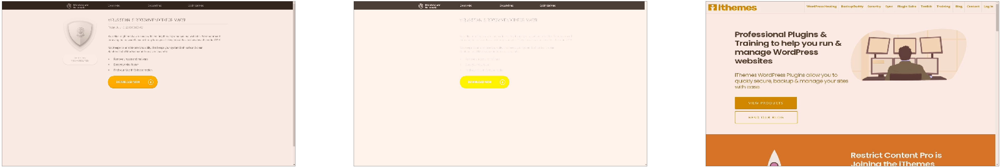

In [39]:
def normalize(x):
    min_val = np.min(x)
    max_val = np.max(x)
    x = (x - min_val) / (max_val - min_val)
    return x

def show(ax, image):
    ax.imshow(normalize(image))
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

COLS = 3
ROWS = 1

for i in range(10): 
    anchor_embedding, positive_embedding, negative_embedding = (
        embedding(tf.expand_dims(anchors[i], axis=0)),
        embedding(tf.expand_dims(positives[i], axis=0)),
        embedding(tf.expand_dims(negatives[i], axis=0)),
    )
    cosine_similarity = metrics.CosineSimilarity()
    positive_similarity = cosine_similarity(anchor_embedding, positive_embedding)

    cosine_similarity = metrics.CosineSimilarity()
    negative_similarity = cosine_similarity(anchor_embedding, negative_embedding)

    print("Loop", i, "Positive similarity", round(positive_similarity.numpy(),6), "Negative similarity", round(negative_similarity.numpy(), 6))

    fig,axs = plt.subplots(ROWS,COLS,figsize=(100, 100))
    
    show(axs[0], anchors[i])
    show(axs[1], positives[i])
    show(axs[2], negatives[i])
    
    plt.show()

## Visualize test dataset and similarities (dataset not shuffled)

- Test dataset consists of 7 malicious clusters and 1 outlier cluster of benign images
- Distance matrix represents the distances between every pair of the test dataset
- Visualizing the distance matrix of the "non-shuffled" dataset helps us see how the model performs by looking at the similarity scores of the images in the actual same cluster

In [40]:
def normalize(x):
    min_val = np.min(x)
    max_val = np.max(x)
    x = (x - min_val) / (max_val - min_val)
    return x

def read_dataset(data_src):    
    count = 0
    directories = os.listdir(data_src)
    directories.sort(key=int)
    directories = directories[:-1]
    for directory in directories:
        count += len([file for file in os.listdir(os.path.join(data_src, directory))])

    X = [None] * count
    y = [None] * count
    idx = 0

    for directory in directories:
        try:
            print('Read directory: ', directory)
            for pic in os.listdir(os.path.join(data_src, directory)):
                img = imread(os.path.join(data_src, directory, pic))
                img = cv2.resize(img, (480,270))

                X[idx] = np.squeeze(np.asarray(img))
                X[idx] = np.asarray(img)
                y[idx] = directory
                idx += 1

        except Exception as e:
            print('Failed to read images from Directory: ', directory)
            print('Exception Message: ', e)
    print('Dataset loaded successfully.')
    return X,y

def preprocessing(test_data_src):
    X, y = read_dataset(test_data_src)

    labels = list(set(y))
    labels.sort(key=int)
    label_dict = dict(zip(labels, range(len(labels))))
    Y = np.asarray([label_dict[label] for label in y])        

    return X, Y

In [41]:
# non-shuffled test images and labels
test_images_ns, test_labels_ns = preprocessing('/data/InJoon/1.5.dataset before augmentation and testing/malicious/test-1/')

Read directory:  47
Read directory:  48
Read directory:  49
Read directory:  57
Read directory:  58
Read directory:  59
Read directory:  63
Read directory:  100
Dataset loaded successfully.


In [42]:
# unique labels and mapping of non-shuffled dataset
unique_test_labels_ns = np.unique(test_labels_ns)
map_test_label_indices_ns = {label: np.flatnonzero(test_labels_ns == label) for label in unique_test_labels_ns}

In [43]:
# define a distance matrix for the non-shuffled dataset
matrix_ns = [[0 for x in range(len(test_labels_ns))] for y in range(len(test_labels_ns))]
rows, cols = len(matrix_ns), len(matrix_ns[0])

# upper right portion of the matrix is defined
for r in range(rows):
    for c in range(r, cols):
        cosine_similarity = metrics.CosineSimilarity()
        im1 = tf.expand_dims(test_images_ns[r], axis=0)
        im2 = tf.expand_dims(test_images_ns[c], axis=0)
        embedding1 = embedding(im1)
        embedding2 = embedding(im2)
        
        # compute similarity score using cosine similarity
        similarity = cosine_similarity(embedding1, embedding2)
        
        # maximum score is kept at 1.0 (some scores go a little over 1.0)
        matrix_ns[r][c] = 1.0 if similarity.numpy() > 1.0 else similarity.numpy()
    
    if r % 10 == 0:
        print("ROW:", r)

ROW: 0
ROW: 10
ROW: 20
ROW: 30
ROW: 40
ROW: 50
ROW: 60
ROW: 70
ROW: 80
ROW: 90


In [44]:
# copy upper triangle of the matrix to the lower triangle
matrix_ns = np.triu(matrix_ns)
matrix_ns = matrix_ns + matrix_ns.T - np.diag(np.diag(matrix_ns))

In [45]:
m = matrix_ns.min()

for r in range(len(test_labels_ns)):
    for c in range(len(test_labels_ns)):
        # normalize against the minimum value
        temp = (matrix_ns[r][c] - m) / (1 - m)
        
        # subtracting the similarity score from 1.0 gives us the distance since distance is the inverse of the similarity score
        matrix_ns[r][c] = 1.0 - temp

## Distance matrix of non-shuffled test dataset

- Black/dark squares along the diagnoal line represents clusters where images in the same cluster has distance close to 0
- The last portion of the diagonal line shows the outliers

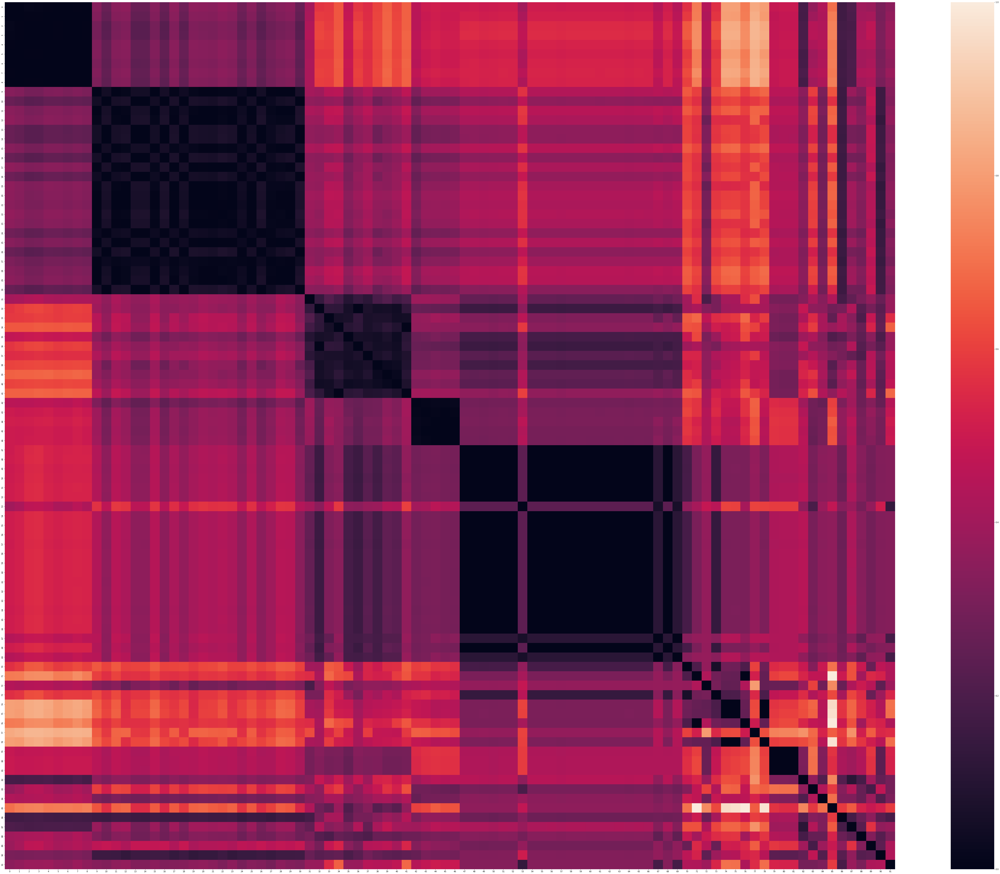

In [46]:
import seaborn as sns

plt.rcParams['figure.figsize'] = [100, 80]
ax = sns.heatmap(matrix_ns, linewidth=0.002)
plt.show()

In [47]:
test_labels_list = list(test_labels_ns)

In [48]:
# store the starting idx of each label
next_label_idxs = [0]
for i in range(1, len(unique_test_labels_ns) + 1):
    if i == len(unique_test_labels_ns):
        next_label_idxs.append(len(test_labels_list))
    else:
        next_label_idxs.append(map_test_label_indices_ns[i][0])

In [49]:
next_label_idxs

[0, 9, 31, 42, 47, 70, 79, 82, 92]

In [50]:
def normalize(x):
    min_val = np.min(x)
    max_val = np.max(x)
    x = (x - min_val) / (max_val - min_val)
    return x

def show(ax, image):
    ax.imshow(normalize(image))
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

def show_test_cluster(i):
    start = next_label_idxs[i]
    end = next_label_idxs[i+1]

    # expand dimensions so that the image fits in the embedding
    im1 = tf.expand_dims(test_images_ns[start], axis=0)
    embedding1 = embedding(im1)

    for j in range(start, end):
        cosine_similarity = metrics.CosineSimilarity()

        im2 = tf.expand_dims(test_images_ns[j], axis=0)
        embedding2 = embedding(im2)
        similarity = cosine_similarity(embedding1, embedding2)
        print("Similarity:", similarity)

        plt.figure(figsize=(5,5))
        plt.imshow(test_images_ns[j])
        plt.show()

## Visualize similarity scores of a sample row from each of the non-shuffled clusters

Similarity: tf.Tensor(1.0000001, shape=(), dtype=float32)


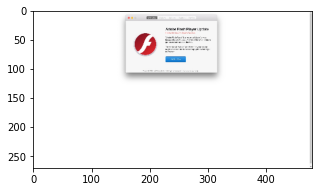

Similarity: tf.Tensor(0.8735141, shape=(), dtype=float32)


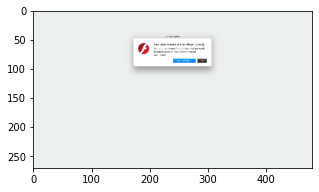

Similarity: tf.Tensor(0.7704639, shape=(), dtype=float32)


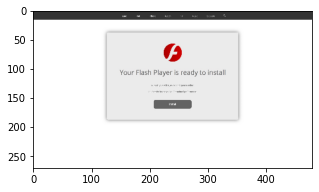

Similarity: tf.Tensor(0.9599713, shape=(), dtype=float32)


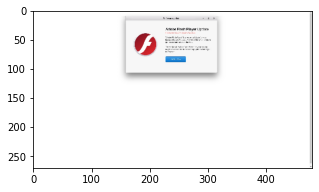

Similarity: tf.Tensor(0.8219991, shape=(), dtype=float32)


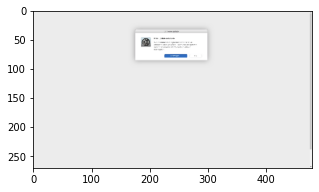

Similarity: tf.Tensor(0.82404685, shape=(), dtype=float32)


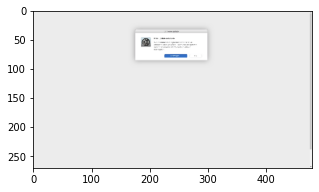

Similarity: tf.Tensor(0.8723226, shape=(), dtype=float32)


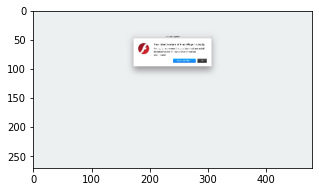

Similarity: tf.Tensor(0.6244495, shape=(), dtype=float32)


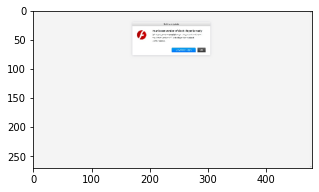

Similarity: tf.Tensor(0.82564175, shape=(), dtype=float32)


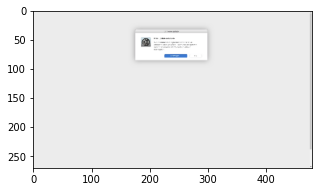

In [56]:
show_test_cluster(5)

## Read the test dataset

In [59]:
def read_dataset(data_src):    
    count = 0
    directories = os.listdir(data_src)
    directories.sort(key=int)
    directories = directories[:-1]
    for directory in directories:
        count += len([file for file in os.listdir(os.path.join(data_src, directory))])

    X = [None] * count
    y = [None] * count
    idx = 0

    for directory in directories:
        try:
            print('Read directory: ', directory)
            for pic in os.listdir(os.path.join(data_src, directory)):
                img = imread(os.path.join(data_src, directory, pic))
                img = cv2.resize(img, (480,270))

                X[idx] = np.squeeze(np.asarray(img))
                y[idx] = directory
                idx += 1

        except Exception as e:
            print('Failed to read images from Directory: ', directory)
            print('Exception Message: ', e)
    print('Dataset loaded successfully.')
    return X,y

def preprocessing(test_data_src):
    X, y = read_dataset(test_data_src)

    labels = list(set(y))
    labels.sort(key=int)
    label_dict = dict(zip(labels, range(len(labels))))
    Y = np.asarray([label_dict[label] for label in y])        

    shuffle_indices = np.random.permutation(np.arange(len(y)))
    x_shuffled = []
    y_shuffled = []

    for index in shuffle_indices:
        x_shuffled.append(X[index])
        y_shuffled.append(Y[index])

    return np.asarray(x_shuffled), np.asarray(y_shuffled)

In [60]:
test_images, test_labels = preprocessing('/data/InJoon/1.5.dataset before augmentation and testing/malicious/test-1/')

Read directory:  47
Read directory:  48
Read directory:  49
Read directory:  57
Read directory:  58
Read directory:  59
Read directory:  63
Read directory:  100
Dataset loaded successfully.


In [61]:
len(test_labels)

92

In [62]:
test_labels

array([2, 4, 4, 1, 2, 4, 7, 5, 7, 2, 7, 1, 0, 1, 3, 4, 1, 4, 1, 2, 1, 4,
       5, 5, 6, 0, 4, 1, 1, 2, 0, 4, 3, 4, 5, 1, 2, 1, 7, 4, 4, 4, 2, 6,
       1, 7, 1, 4, 1, 0, 5, 3, 5, 2, 0, 5, 2, 5, 1, 7, 6, 4, 4, 4, 3, 7,
       2, 1, 7, 3, 0, 0, 4, 1, 4, 7, 7, 4, 4, 0, 1, 4, 5, 2, 4, 1, 1, 4,
       0, 1, 1, 1])

In [63]:
unique_test_labels = np.unique(test_labels)

In [64]:
map_test_label_indices = {label: np.flatnonzero(test_labels == label) for label in unique_test_labels}

## Define the distance matrix

In [65]:
# define a distance matrix for the shuffled test dataset
matrix = [[0 for x in range(len(test_labels))] for y in range(len(test_labels))]
rows, cols = len(matrix), len(matrix[0])

# upper right portion of the matrix is defined
for r in range(rows):
    for c in range(r, cols):
        cosine_similarity = metrics.CosineSimilarity()
        im1 = tf.expand_dims(test_images[r], axis=0)
        im2 = tf.expand_dims(test_images[c], axis=0)
        embedding1 = embedding(im1)
        embedding2 = embedding(im2)
        
        # compute similarity score using cosine similarity
        similarity = cosine_similarity(embedding1, embedding2)
        
        # maximum score is kept at 1.0 (some scores go a little over 1.0)
        matrix[r][c] = 1.0 if similarity.numpy() > 1.0 else similarity.numpy()
    
    if r % 10 == 0:
        print("ROW:", r)

ROW: 0
ROW: 10
ROW: 20
ROW: 30
ROW: 40
ROW: 50
ROW: 60
ROW: 70
ROW: 80
ROW: 90


In [66]:
# copy upper triangle of the matrix to the lower triangle
matrix = np.triu(matrix)
matrix = matrix + matrix.T - np.diag(np.diag(matrix))

In [67]:
m = matrix.min()

for r in range(len(test_labels)):
    for c in range(len(test_labels)):
        # normalize against the minimum value
        temp = (matrix[r][c] - m) / (1 - m)
        
        # subtracting the similarity score from 1.0 gives us the distance since distance is the inverse of the similarity score
        matrix[r][c] = 1.0 - temp

## Find the Optimal Value for Epsilon

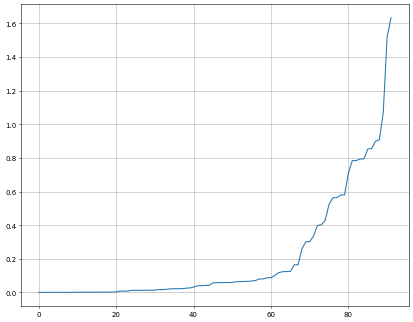

In [69]:
from sklearn.neighbors import NearestNeighbors

# locate the optimal epsilon value where the curvature is maximum in the graph
neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(matrix)
distances, indices = nbrs.kneighbors(matrix)

distances = np.sort(distances, axis=0)
distances = distances[:,1]

fig = plt.figure()
ax = fig.gca()
ax.set_yticks(np.arange(0, 4., 0.2))
plt.grid()
plt.rcParams['figure.figsize'] = [10, 8]
plt.rcParams['figure.dpi'] = 50
plt.plot(distances)

## DBSCAN

In [76]:
from sklearn.cluster import DBSCAN

distance_matrix = np.array(matrix)

# adjust the eps and min_samples values while the list(set(cluster)) == number of clusters we have in the test dataset
clustering = DBSCAN(eps=0.85, min_samples=3).fit(distance_matrix)
cluster = clustering.labels_
list(set(cluster))

[0, 1, 2, 3, 4, 5, 6, -1]

In [77]:
# sort cluster and keep track of label
sorted_cluster_labels = [i[0] for i in sorted(enumerate(cluster), key=lambda x:x[1], reverse=True)]

In [78]:
# make a copy of test images
test_dataset = test_images.copy()
test_dataset = np.array(test_dataset)

# make a copy of test labels
test_labels_copy = test_labels.copy()

In [79]:
# rearrange test images based on the sorted cluster label
test_dataset = test_dataset[sorted_cluster_labels]

# rearrange labels accordingly as well
test_labels_copy = test_labels_copy[sorted_cluster_labels]

In [80]:
test_labels_copy

array([6, 6, 6, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 5, 5, 5, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 7, 7, 7, 5, 5, 5, 7, 7, 5, 5, 5, 7, 4,
       7, 7, 7, 7])

In [81]:
# rearrange rows and cols based on the DBSCAN cluster labels
distance_matrix = distance_matrix[:, sorted_cluster_labels]
distance_matrix = distance_matrix[sorted_cluster_labels, :]

## Distance matrix: before clustering

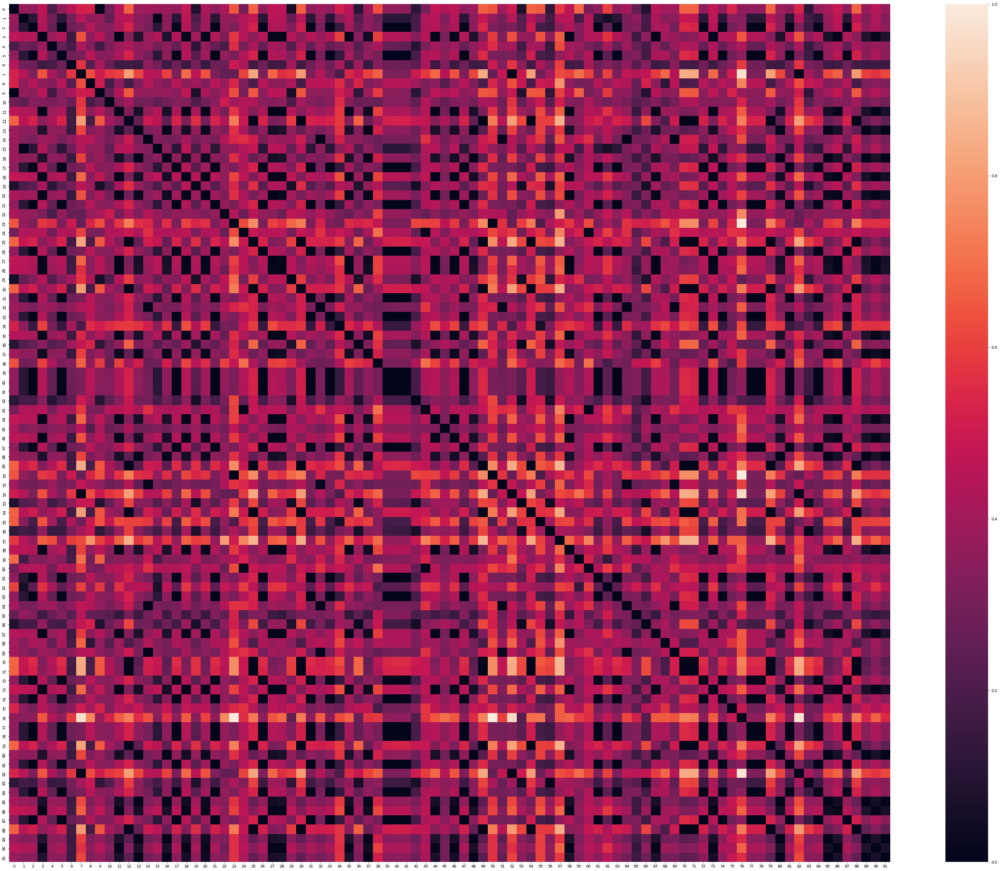

In [97]:
import seaborn as sns

plt.rcParams['figure.figsize'] = [50, 40]
ax = sns.heatmap(matrix, linewidth=0.002)
plt.show()

## Distance matrix: after clustering

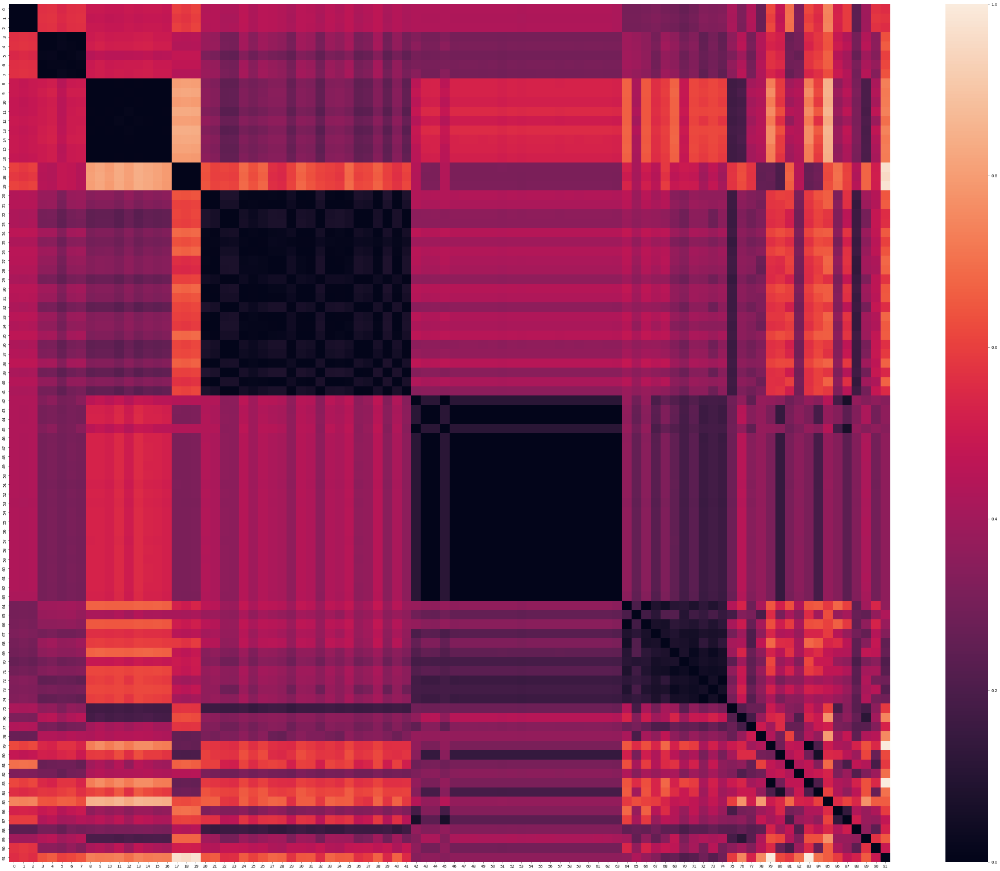

In [98]:
ax = sns.heatmap(distance_matrix, linewidth=0.002)
plt.show()

## Visualize Clusters

- Each row represents a cluster

In [84]:
sorted_cluster = sorted(cluster, reverse=True)
cluster_unq_list = list(set(cluster))

## reverse the list so that the outlier group (-1) falls last
cluster_unq_list = sorted(cluster_unq_list, reverse=True)

In [85]:
cluster_unq_list

[6, 5, 4, 3, 2, 1, 0, -1]

In [86]:
total = len(test_labels)

# find the ending indices of each cluster in the sorted_cluster 
# by finding the starting index of the following cluster
for i in range(len(cluster_unq_list)):
    if i == len(cluster_unq_list)-1:
        next_label_idx = total
    else:
        next_label_idx = sorted_cluster.index(cluster_unq_list[i+1])
    print(next_label_idx)

3
8
17
20
42
64
75
92


[2 1 1]
[7 4 4]
[ 9  9 15]
[17 17 19]
[29 24 36]
[48 54 53]
[67 67 68]
[81 79 75]


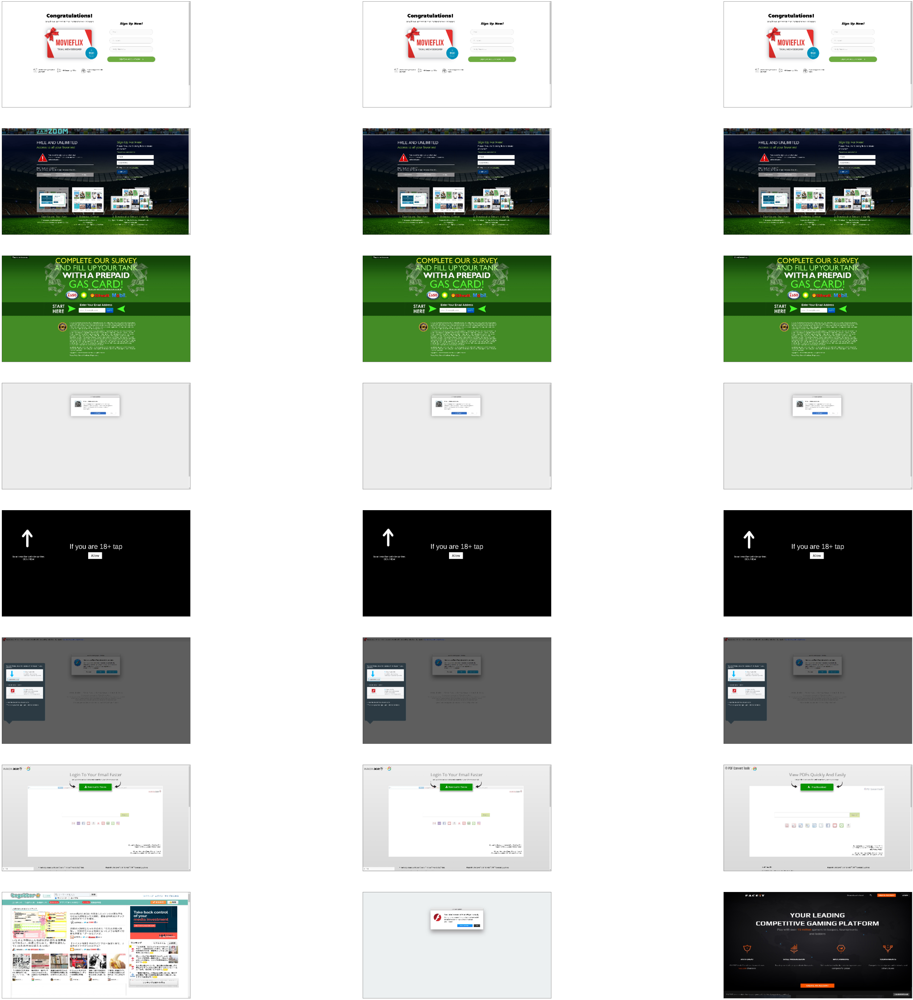

In [87]:
def show(ax, image):
    ax.imshow(image)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

COL = 3
fig_len = len(cluster_unq_list) * COL
fig, axs = plt.subplots(len(cluster_unq_list),COL,figsize=(100, 100))

start_idx = 0
for i in range(len(cluster_unq_list)):
    # index of the next label
    if i == len(cluster_unq_list)-1:
        next_label_idx = total
    else:
        next_label_idx = sorted_cluster.index(cluster_unq_list[i+1])
    
    # choose 5 indices randomly that belong to the same label
    five_random_idx = np.random.choice(list(range(start_idx, next_label_idx)), COL, replace=True)
    start_idx = next_label_idx
    print(five_random_idx)

    show(axs[i,0], test_dataset[five_random_idx[0]])
    show(axs[i,1], test_dataset[five_random_idx[1]])
    show(axs[i,2], test_dataset[five_random_idx[2]])

## Visualization of non-shuffled triplets with similarity scores

In [88]:
map_test_label_indices_ns

{0: array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 1: array([ 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25,
        26, 27, 28, 29, 30]),
 2: array([31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41]),
 3: array([42, 43, 44, 45, 46]),
 4: array([47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63,
        64, 65, 66, 67, 68, 69]),
 5: array([70, 71, 72, 73, 74, 75, 76, 77, 78]),
 6: array([79, 80, 81]),
 7: array([82, 83, 84, 85, 86, 87, 88, 89, 90, 91])}

In [89]:
unique_test_labels[:-1]

array([0, 1, 2, 3, 4, 5, 6])

Loop 0 Positive similarity 0.991421 Negative similarity 0.753416


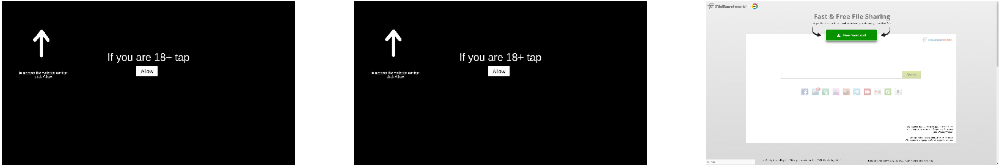

Loop 1 Positive similarity 0.865368 Negative similarity 0.747388


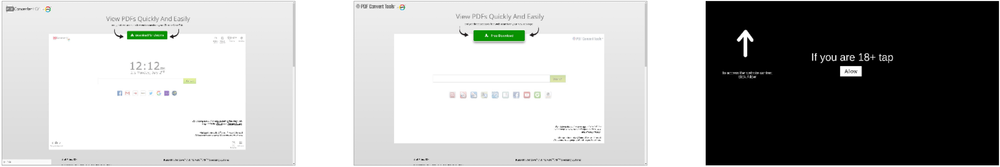

Loop 2 Positive similarity 0.867558 Negative similarity 0.720138


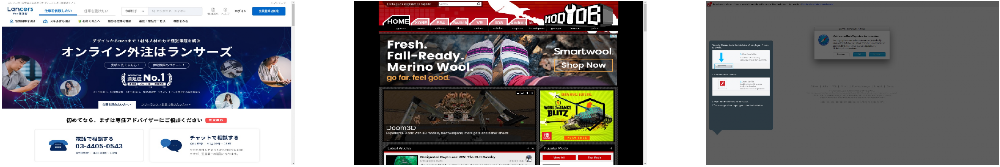

Loop 3 Positive similarity 0.994814 Negative similarity 0.769434


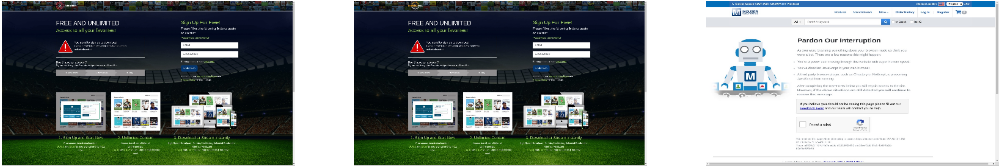

Loop 4 Positive similarity 0.764408 Negative similarity 0.704712


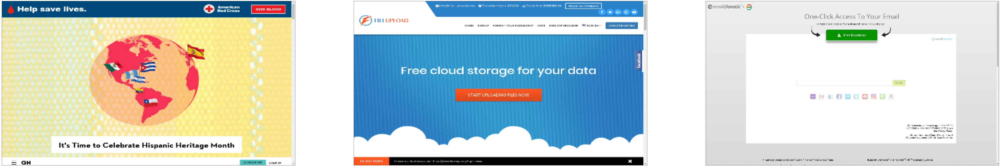

Loop 5 Positive similarity 0.997626 Negative similarity 0.698482


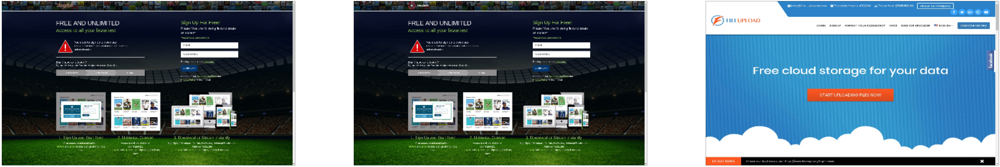

Loop 6 Positive similarity 0.998536 Negative similarity 0.584487


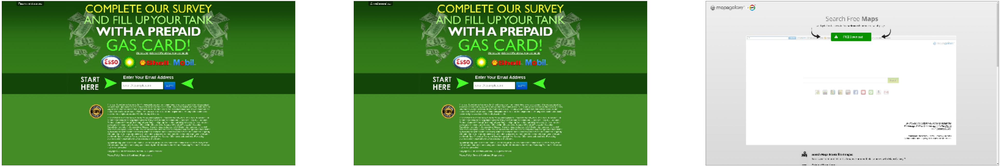

Loop 7 Positive similarity 0.99988 Negative similarity 0.728918


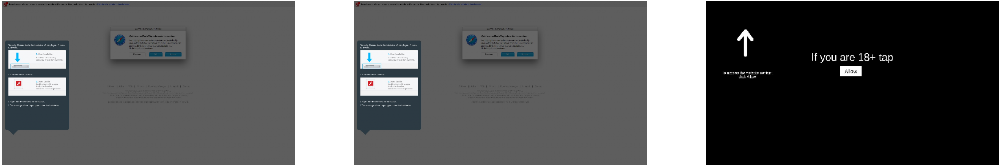

Loop 8 Positive similarity 0.965769 Negative similarity 0.78433


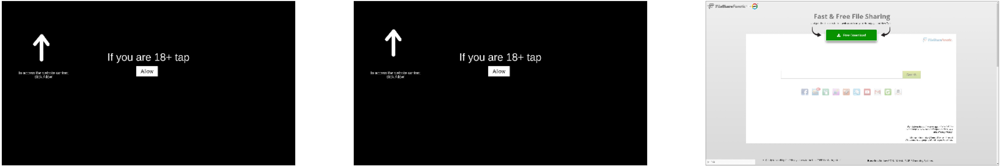

Loop 9 Positive similarity 0.998536 Negative similarity 0.616832


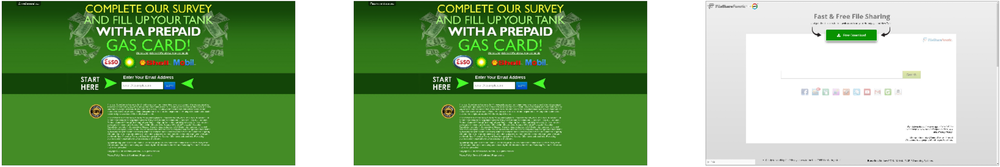

In [96]:
def normalize(x):
    min_val = np.min(x)
    max_val = np.max(x)
    x = (x - min_val) / (max_val - min_val)
    return x

def show(ax, image):
    ax.imshow(normalize(image))
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

COLS = 3
ROWS = 1

for i in range(10):
    label_l, label_r = np.random.choice(unique_test_labels,2, replace=False)
    a, p = np.random.choice(map_test_label_indices_ns[label_l],2, replace=False)
    n = np.random.choice(map_test_label_indices_ns[label_r])
    
    anchor_embedding, positive_embedding, negative_embedding = (
        embedding(tf.expand_dims(test_images_ns[a], axis=0)),
        embedding(tf.expand_dims(test_images_ns[p], axis=0)),
        embedding(tf.expand_dims(test_images_ns[n], axis=0)),
    )
    cosine_similarity = metrics.CosineSimilarity()
    positive_similarity = cosine_similarity(anchor_embedding, positive_embedding)

    cosine_similarity = metrics.CosineSimilarity()
    negative_similarity = cosine_similarity(anchor_embedding, negative_embedding)

    print("Loop", i, "Positive similarity", round(positive_similarity.numpy(),6), "Negative similarity", round(negative_similarity.numpy(), 6))

    fig,axs = plt.subplots(ROWS,COLS,figsize=(100, 100))
    
    show(axs[0], test_images_ns[a])
    show(axs[1], test_images_ns[p])
    show(axs[2], test_images_ns[n])
    
    plt.show()

## Image Pairs for Precision and Recall

In [90]:
def generate_image_pairs(test_images):
    image_pairs = []
    labels = []

    for _ in range(len(test_labels)):
        # image pairs from the same cluster
        random_label = np.random.choice(unique_test_labels)
        a, p = np.random.choice(map_test_label_indices[random_label], 2, replace=False)

        # image_pairs.append((test_images[a], test_images[p]))
        image_pairs.append((a, p))
        labels.append(1)
            
    for _ in range(len(test_labels)):
        # image pairs from different clusters
        label_l, label_r = np.random.choice(unique_test_labels, 2, replace=False)
        a = np.random.choice(map_test_label_indices[label_l])
        n = np.random.choice(map_test_label_indices[label_r])

        # image_pairs.append((test_images[a], test_images[n]))
        image_pairs.append((a, n))
        labels.append(0)
    
    return image_pairs, labels

val_image_pairs, val_labels = generate_image_pairs(test_images)

In [91]:
predicted_labels = []

for idx1, idx2 in val_image_pairs:
    if cluster[idx1] != cluster[idx2]:
        predicted_labels.append(0)
    else:
        predicted_labels.append(1)

In [92]:
import numpy as np
from sklearn.metrics import jaccard_score

jaccard_score(val_labels, predicted_labels)

0.9052631578947369

In [93]:
from tensorflow.keras.metrics import Precision, Recall

m = Recall()
m.update_state(val_labels, predicted_labels)
m.result().numpy()

0.9347826

In [94]:
correct = 0
incorrect = 0
for i in range(len(predicted_labels)):
#     if predicted_labels[i] == -1:
#         continue

    if predicted_labels[i] == val_labels[i]:
        correct += 1
    else:
        incorrect += 1

In [95]:
correct / (correct + incorrect)

0.9510869565217391